In [152]:
save_folders =[r'\\192.168.0.10\bbfishdc13\DCBBL1_3_2_2023\MERFISH_Analysis',
              r'\\192.168.0.100\bbfish100\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023\MERFISH_Analysis',
              r'\\192.168.0.100\bbfish100\DCBBL1_4week_6_2_2023\MERFISH_Analysis',
              r'\\192.168.0.21\bbfishdc21\DCBBL1_1year1wkNJ_ASO_SAL_3_31_2023\MERFISH_Analysis']

In [8]:
import sys
sys.path.append(r'..//')
from ioMicro import *
import pandas as pd

In [41]:
import pandas as pd
def get_df__cell_df(save_folder,iset=0):
    #save_folder = save_folders[1]
    save_folder_ =save_folder+r'\final_spots'
    saved_fls = glob.glob(save_folder_+os.sep+'*_cell_df_newCellSeg.pkl')
    save_fl = saved_fls[iset]
    #df = pd.read_pickle(save_folder+r'\DCBBL1_3_2_2023_set1-2_df_newCellSeg.pkl')
    df = pd.read_pickle(save_fl.replace('_cell_df_','_df_'))
    #cell_df = pd.read_pickle(save_folder+r'\DCBBL1_3_2_2023_set1-2_cell_df_newCellSeg.pkl')
    cell_df = pd.read_pickle(save_fl)
    return df,cell_df

In [181]:
save_folderR=save_folders[1]
dfR,cell_dfR = get_df__cell_df(save_folderR,iset=1)
genes = [gn for gn in dfR.columns if '_smFISH' not in gn and 'blank' not in gn]
#print(genes)

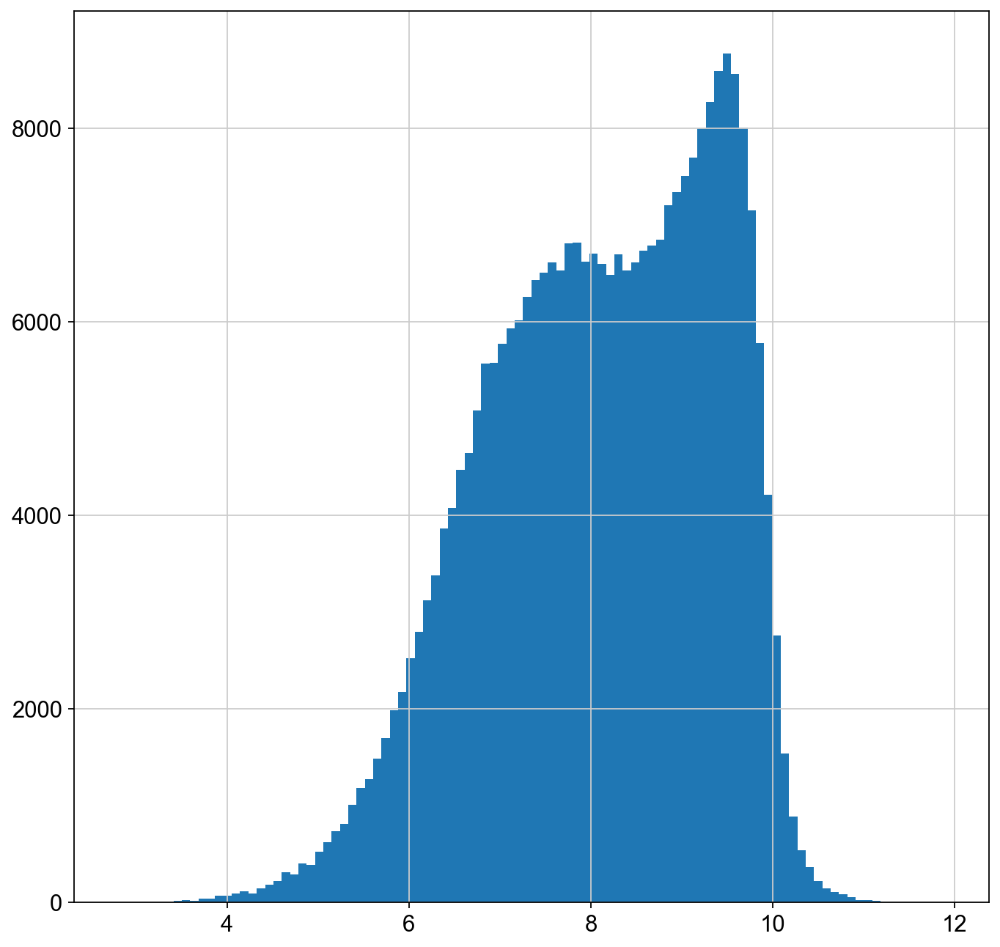

In [182]:
plt.hist(np.log(cell_dfR['volm']),bins=100);

In [184]:
np.median(cell_dfR['volm'])

3669.0

In [183]:
np.exp(8)

2980.9579870417283

In [78]:
gene = 'Dlx2'
v= plot_gene_mosaic_cells(dfR,cell_dfR,gene,plt_fov=False,pixel_size = 0.10833*4,transpose=1,th_blank=np.inf)

In [199]:
genes = [gn for gn in dfR.columns if '_smFISH' not in gn and 'blank' not in gn]
dfR_ = dfR[genes].copy()
dfR_ = dfR_.replace(np.nan, 0)
keep = cell_dfR['volm']>2500
dfR_ = dfR_.loc[keep]
cell_dfR_ = cell_dfR.loc[keep]


C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\1260496605.py:4: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


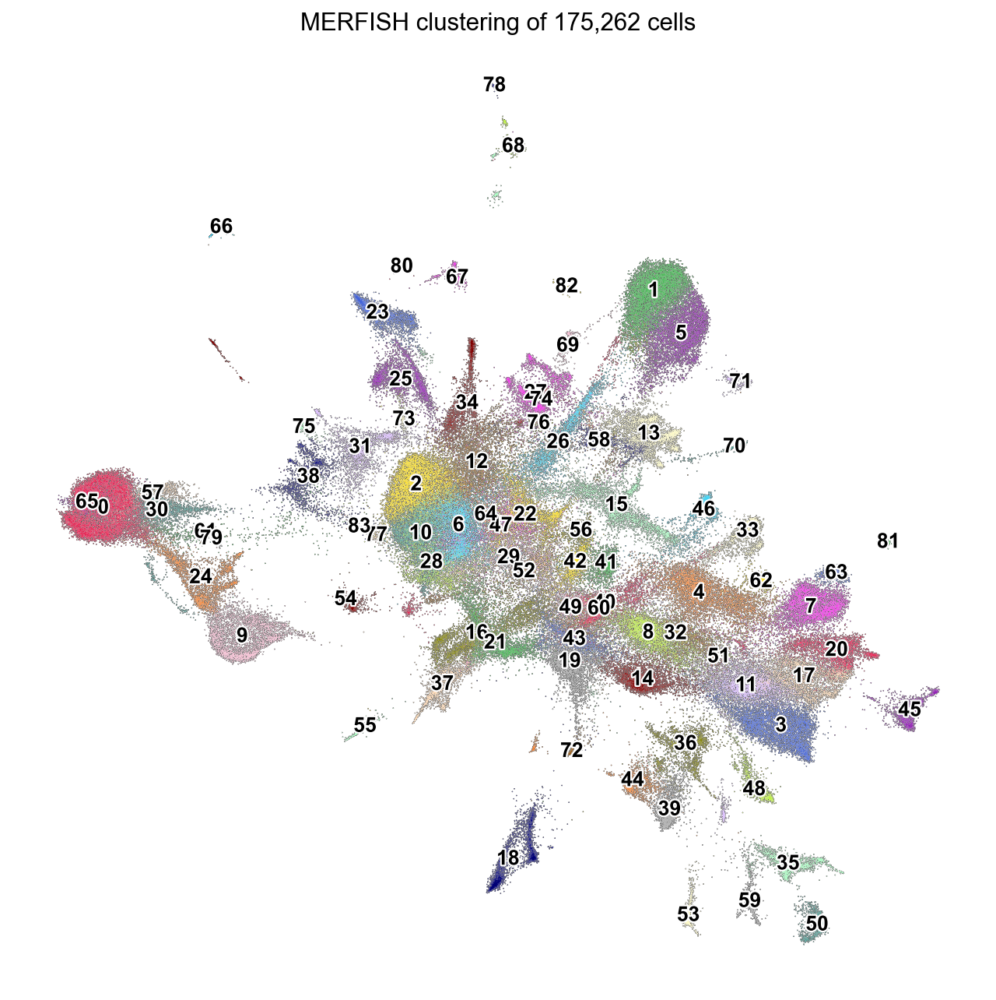

In [200]:
import scanpy as sc
from scipy.stats import zscore
import numpy as np
scdata2 = sc.AnnData(dfR_)
scdata2.obsm["X_spatial"] = get_Xcells(cell_dfR_,pixel_size = 0.10833*4,transpose=1,flipx=1,flipy=1)
sc.pp.filter_cells(scdata2, min_genes=5)
sc.pp.calculate_qc_metrics(scdata2, percent_top=None, inplace=True)
sc.pp.normalize_total(scdata2, target_sum=np.median(scdata2.obs["total_counts"]))

### Tried volume normalization but did not work well.

#volume = np.array(list(celldata['volume'].reindex(index=scdata.obs.index.astype(int))),dtype=np.float)
#scdata.X = scdata.X/volume[:,np.newaxis]*np.median(volume)
sc.pp.log1p(scdata2)


### Should we use PCA?

### Should we do z-scores. Explore this with spatial maps. Visual inspection. ---Colin

sc.pp.neighbors(scdata2, use_rep = "X")  #metric='correlation'
sc.tl.leiden(scdata2, resolution=4) #### 
#plt.figure()
sc.tl.umap(scdata2,random_state=9,min_dist=0.3)
cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
        "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
        "#000075", "#a9a9a9"]

sc.set_figure_params(figsize=(10,10))
sc.pl.umap(
    scdata2,
    color="leiden",
    add_outline=True,
    legend_loc="on data",
    legend_fontsize=12,
    legend_fontoutline=2,
    frameon=False,
    title=f"MERFISH clustering of {len(scdata2):,d} cells",
    palette=cmap
)

In [261]:
scdata2.write_h5ad(r'D:\scdatas\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023__iset1.h5ad')

In [282]:
scdata2=sc.read_h5ad(r'D:\scdatas\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023__iset1.h5ad')
sc.pp.pca(scdata2)

In [293]:
gns_ = np.sort(np.array(scdata2.var.index))
scdata2 = scdata2[:,gns_]

View of AnnData object with n_obs × n_vars = 175262 × 275
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'leiden'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap', 'pca'
    obsm: 'X_spatial', 'X_umap', 'X_pca'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [267]:
def get_scdata(dfR,cell_dfR,genes_prev=None,th_vol = 2500,pixel_size=0.10833*4):
    genes = [gn for gn in dfR.columns if '_smFISH' not in gn and 'blank' not in gn]
    if genes_prev is not None:
        genes = np.intersect1d(genes_prev,genes)
    dfR_ = dfR[genes].copy()
    dfR_ = dfR_.replace(np.nan, 0)
    keep = cell_dfR['volm']>th_vol
    dfR_ = dfR_.loc[keep]
    cell_dfR_ = cell_dfR.loc[keep]
    scdata2 = sc.AnnData(dfR_)
    scdata2.obsm["X_spatial"] = get_Xcells(cell_dfR_,pixel_size =pixel_size ,transpose=1,flipx=1,flipy=1)
    scdata2.obsm["X_raw"] = scdata2.X.copy()
    sc.pp.calculate_qc_metrics(scdata2, percent_top=None, inplace=True)
    sc.pp.normalize_total(scdata2, target_sum=np.median(scdata2.obs["total_counts"]))
    sc.pp.log1p(scdata2)
    sc.pp.neighbors(scdata2,use_rep = "X")  #metric='correlation', use_rep = "X"
    #sc.tl.leiden(scdata2, resolution=2) 
    #sc.tl.umap(scdata2,random_state=9)
    sc.pp.pca(scdata2)
    return scdata2

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero c

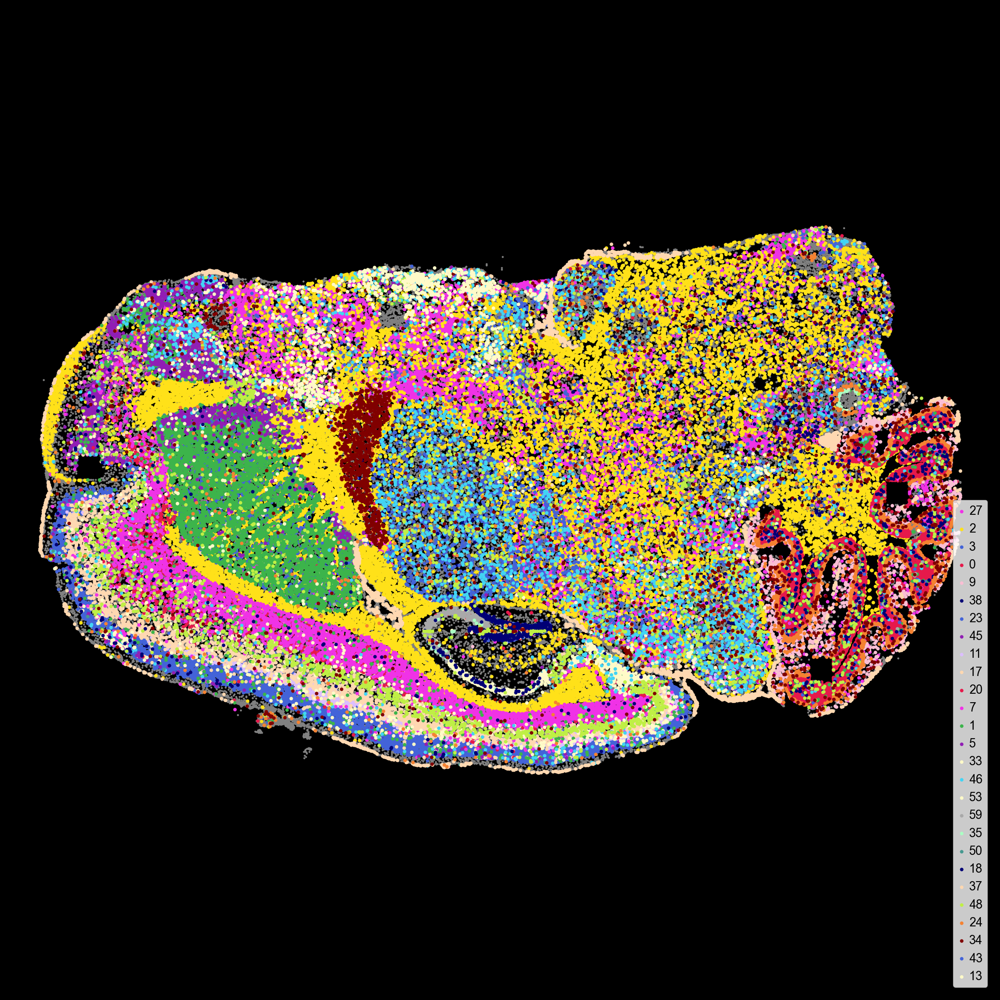

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero c

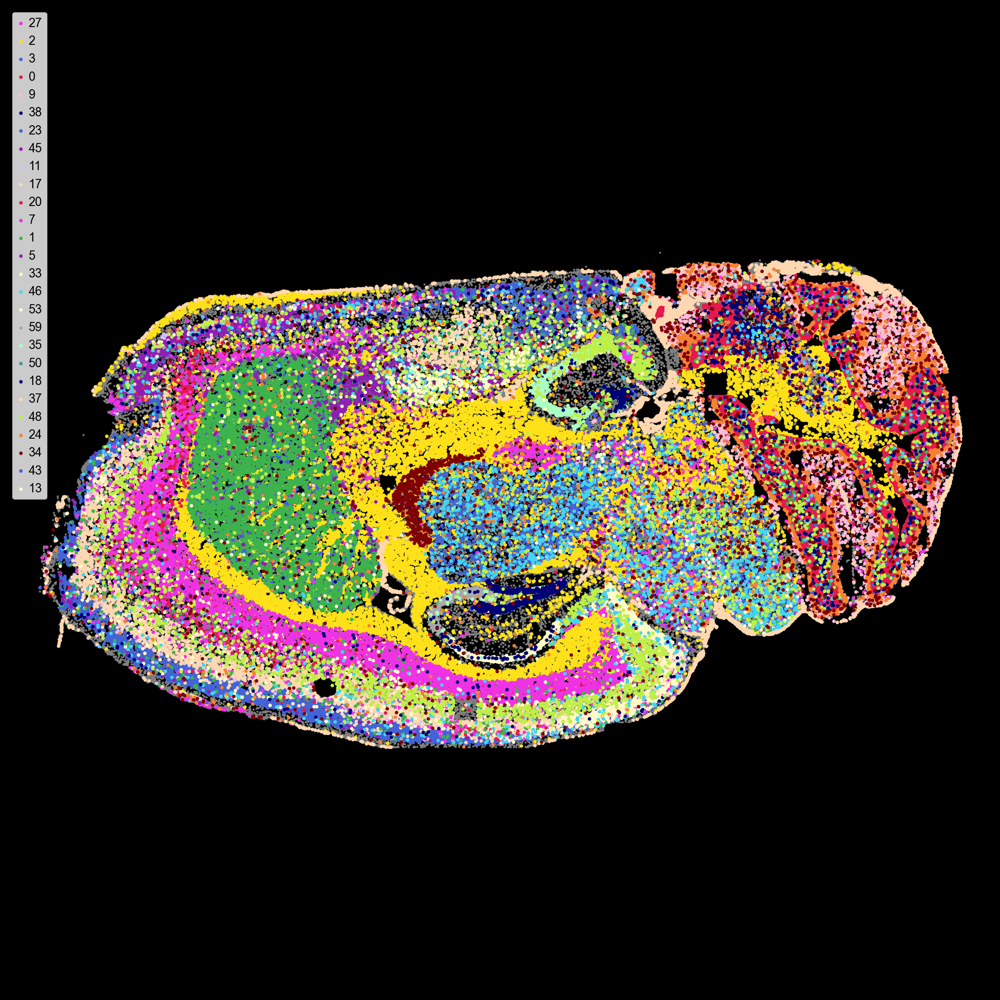

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

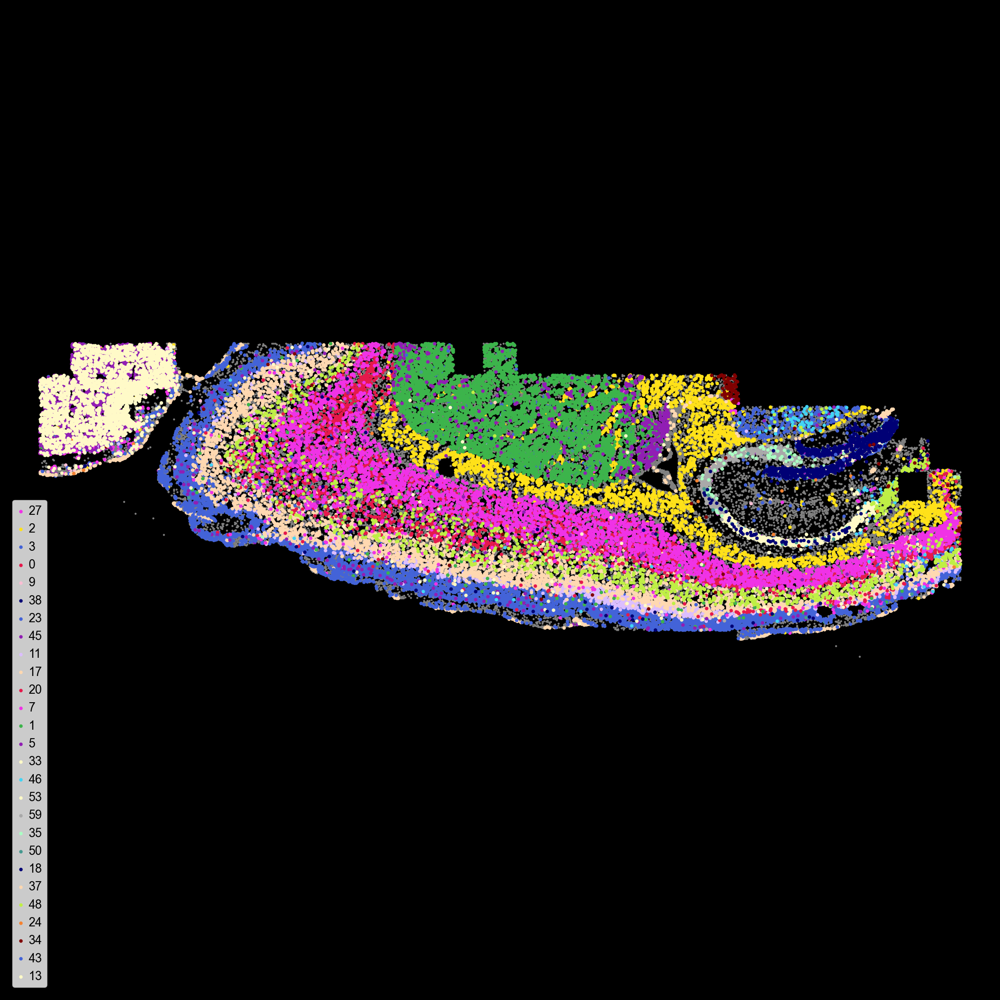

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

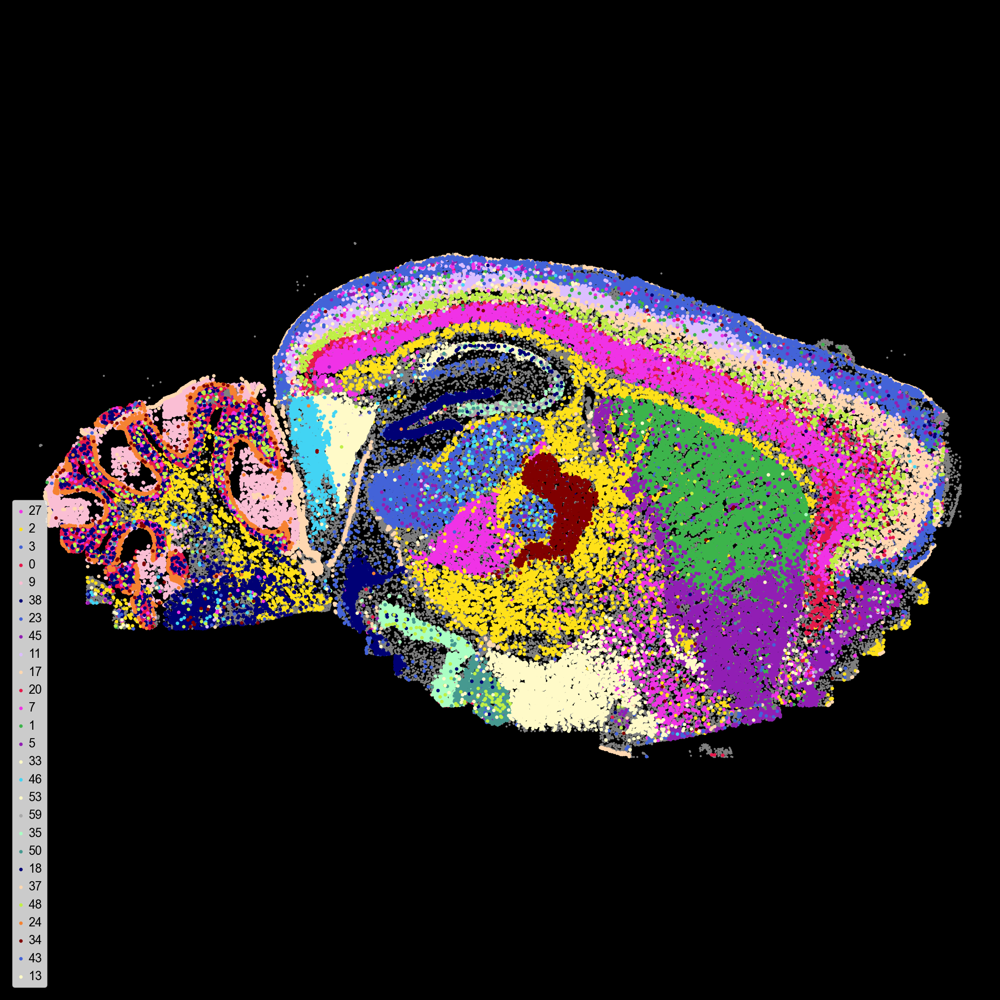

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

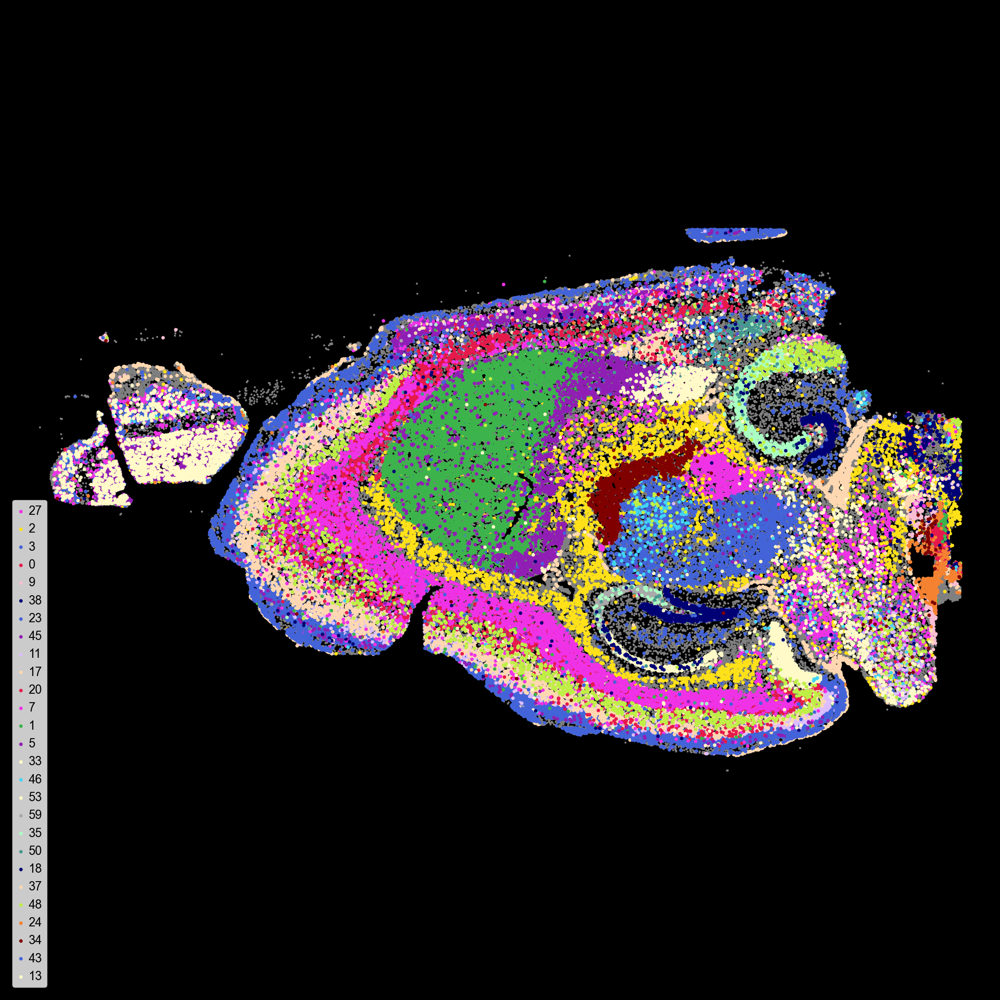

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

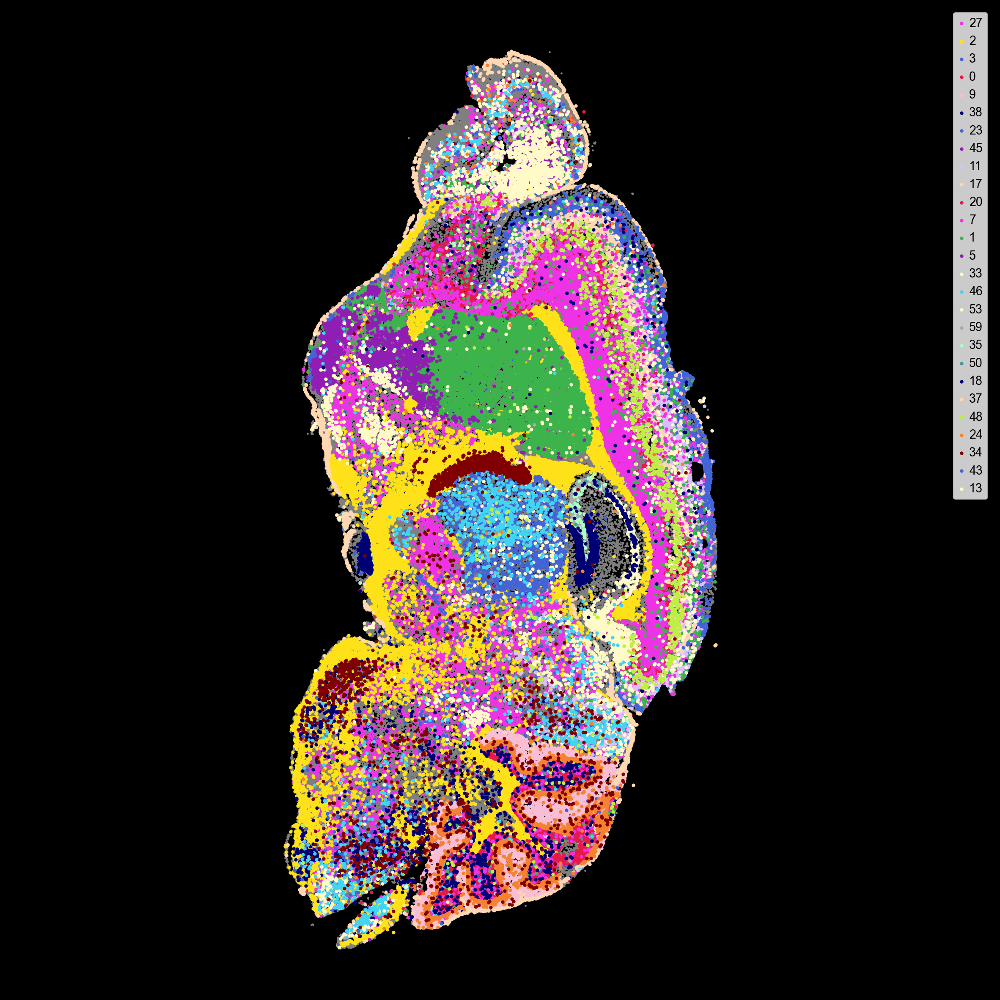

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

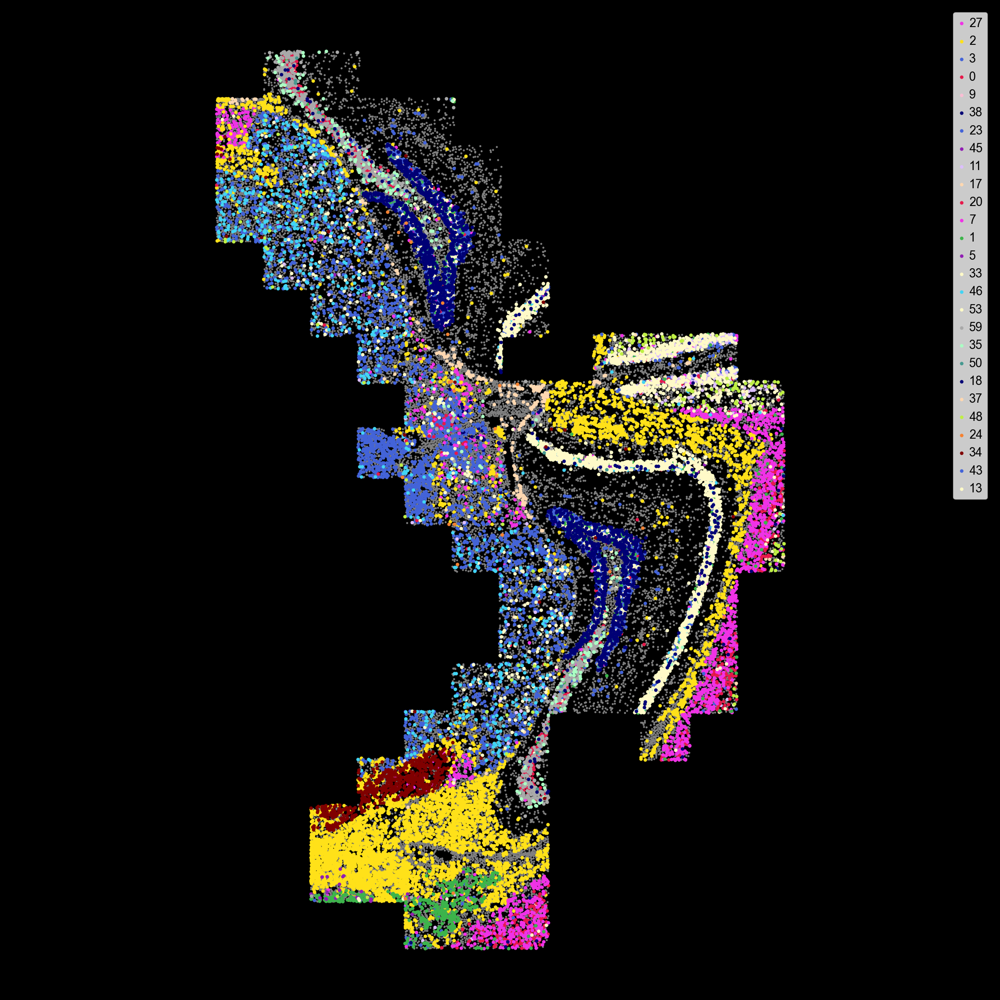

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

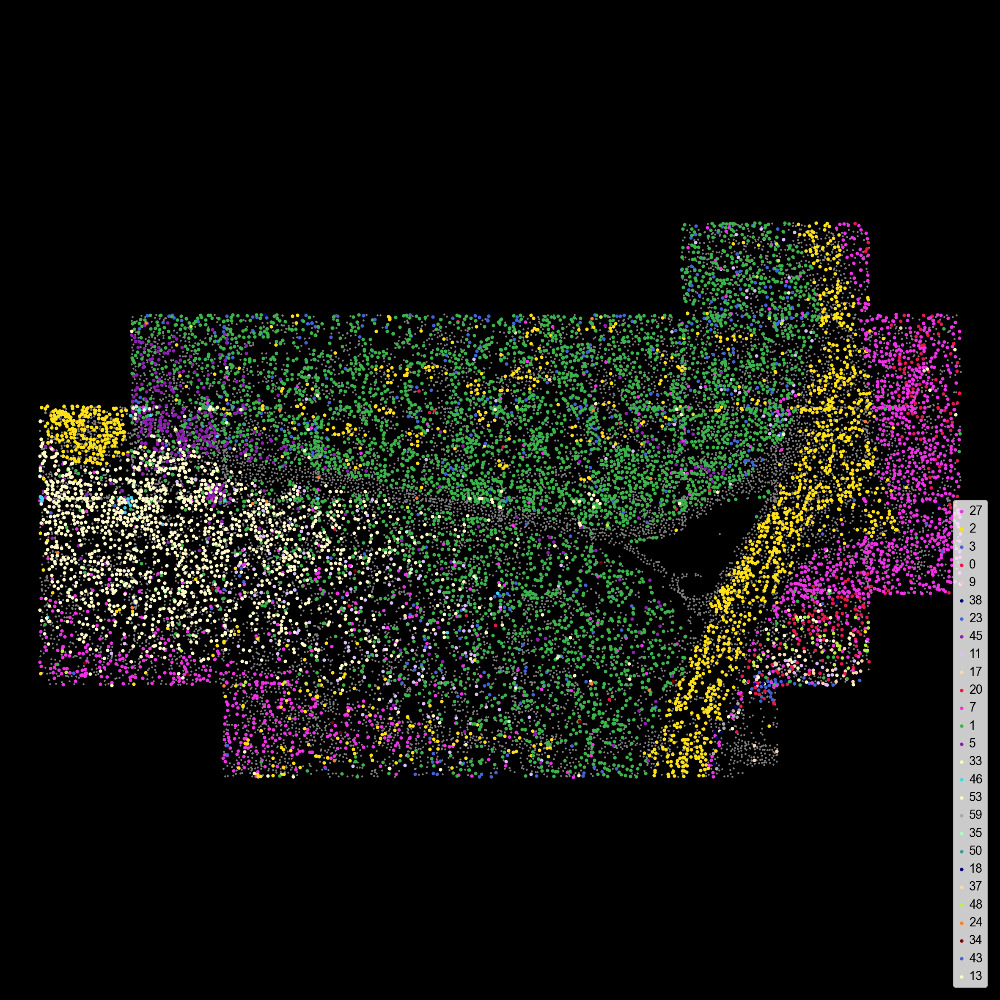

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

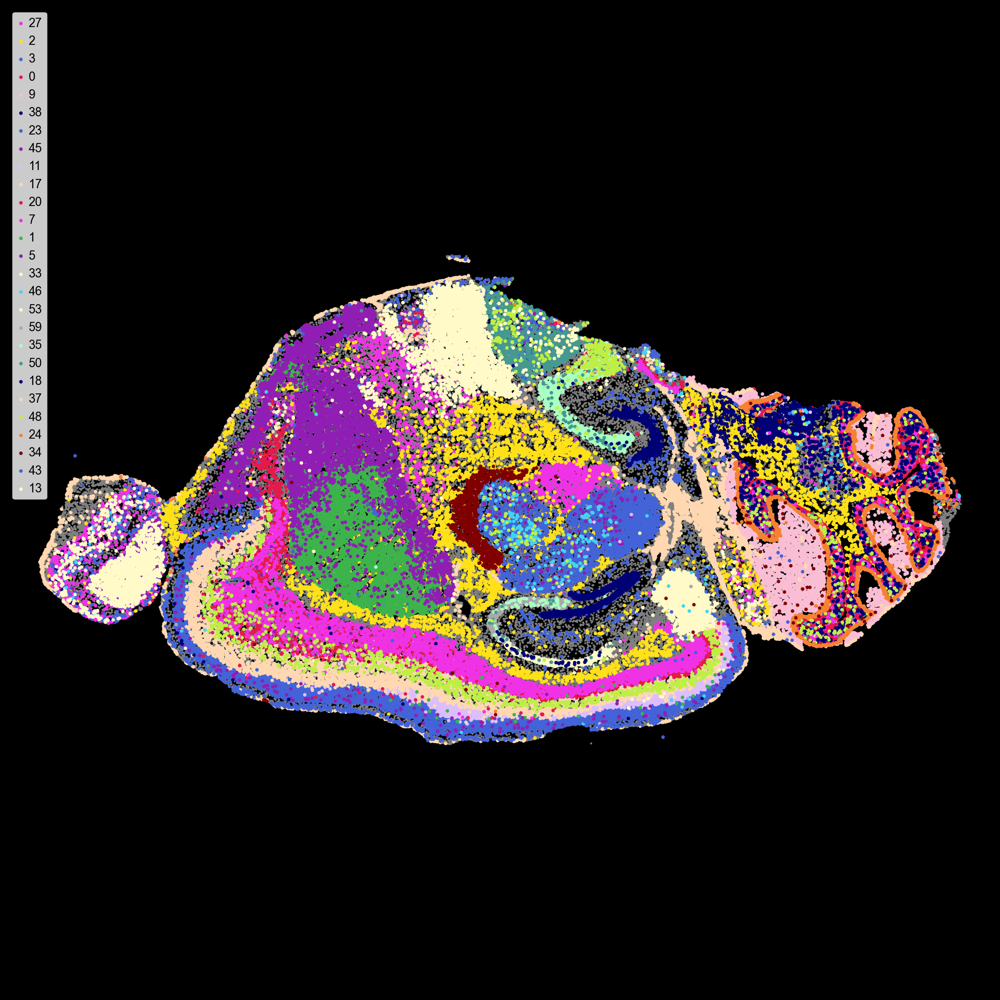

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=False)


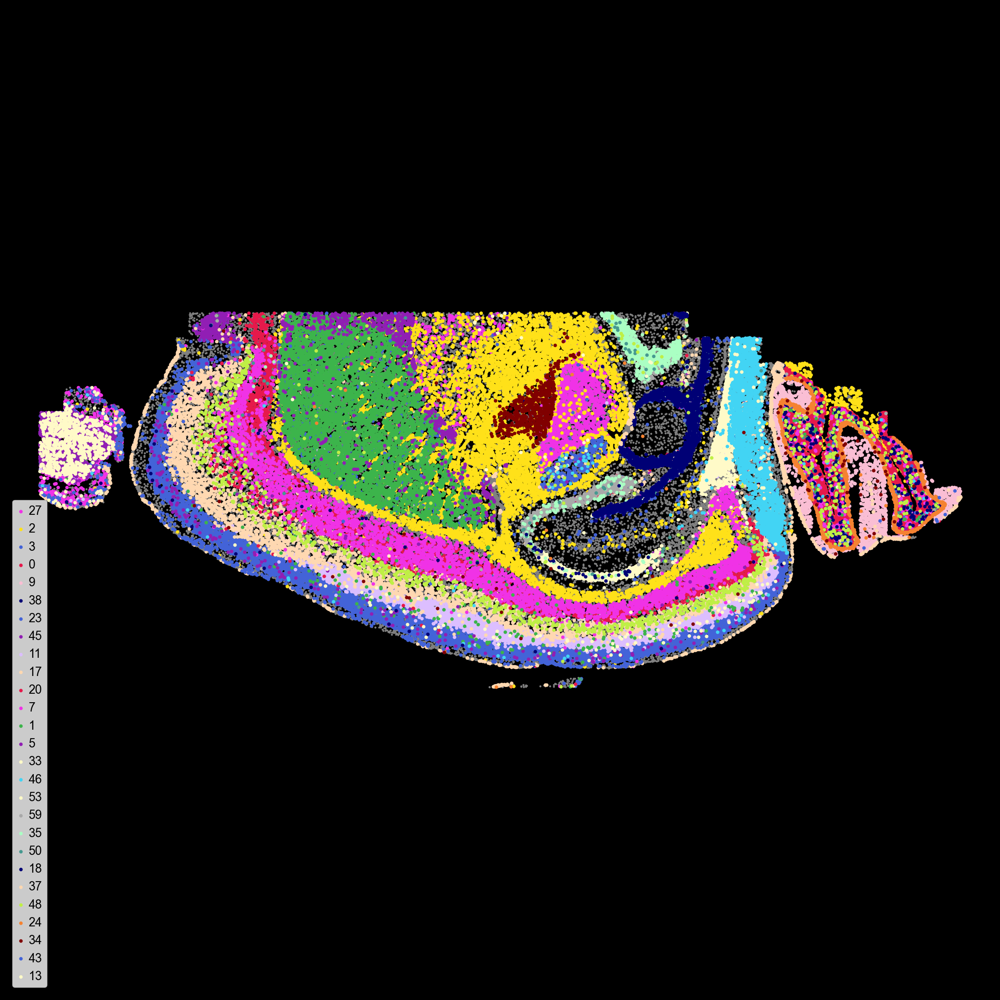

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\3380448905.py:10: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  scdata2 = sc.AnnData(dfR_)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\scanpy\preprocessing\_normalization.py:197: UserWarning: Some cells have zero counts
  warn(UserWarning('Some cells have zero counts'))
C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped

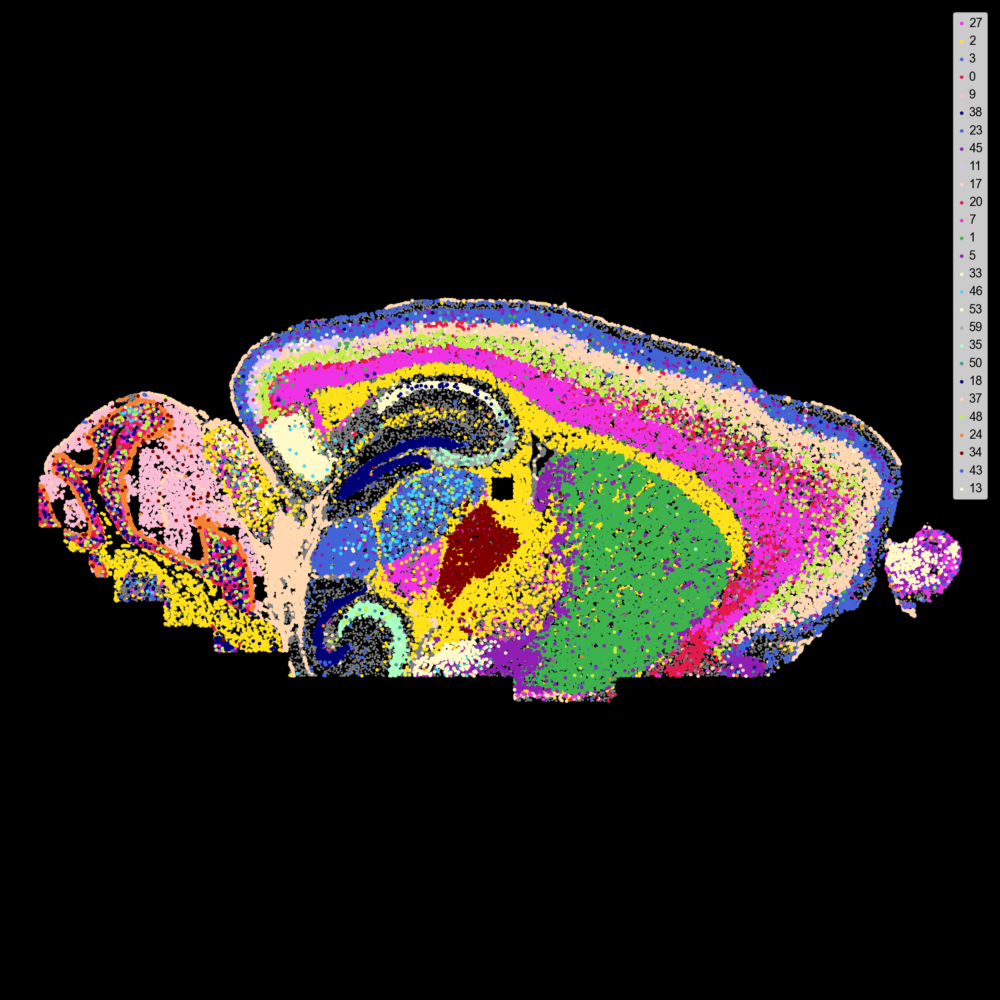

In [299]:
for save_folder in save_folders:
    save_folder_ =save_folder+r'\final_spots'
    saved_fls = glob.glob(save_folder_+os.sep+'*_cell_df_newCellSeg.pkl')
    for iset in range(len(saved_fls)):
        scdata2=sc.read_h5ad(r'D:\scdatas\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023__iset1.h5ad')
        df,cell_df = get_df__cell_df(save_folder,iset=iset)
        genes_prev = list(scdata2.var.index)
        scdata1 = get_scdata(df,cell_df,genes_prev,th_vol = 2500,pixel_size=0.10833*4)
        scdata2 = scdata2[:,scdata1.var.index]
        sc.pp.pca(scdata2)
        sc.tl.ingest(scdata1,scdata2,obs='leiden')
        plot_cluster_scdata(scdata1,cmap,clusters=[27,2,3,0,9,38,23,45,11,17,20,7,1,5,33,46,53,59,35,50,18,37,48,24,34,43,13],transpose=1,flipx=1,flipy=-1)
        plt.show()
        scdata1.write_h5ad(r'D:\scdatas'+os.sep+os.path.basename(os.path.dirname(save_folder))+'_iset'+str(iset)+'.h5ad')

In [ ]:
scdata1 = sc.read_h5ad()

In [301]:
fls = glob.glob(r'D:\scdatas\*.h5ad')

['D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_3_31_2023_iset0.h5ad',
 'D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_3_31_2023_iset1.h5ad',
 'D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_3_31_2023_iset2.h5ad',
 'D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023_iset0.h5ad',
 'D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023_iset1.h5ad',
 'D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023_iset2.h5ad',
 'D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023__iset1 - Copy.h5ad',
 'D:\\scdatas\\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023__iset1.h5ad',
 'D:\\scdatas\\DCBBL1_3_2_2023_iset0.h5ad',
 'D:\\scdatas\\DCBBL1_3_2_2023_iset1.h5ad',
 'D:\\scdatas\\DCBBL1_4week_6_2_2023_iset0.h5ad',
 'D:\\scdatas\\DCBBL1_4week_6_2_2023_iset1.h5ad',
 'D:\\scdatas\\DCBBL1_4week_6_2_2023_iset2.h5ad']

In [439]:
reffl = r'D:\scdatas\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023__iset1 - reference.h5ad'
scdata1 = sc.read_h5ad(reffl)
scdata2 = sc.read_h5ad(fls[-4])

leid1 = scdata1.obs['leiden']
ls1 = [l for l in np.unique(leid1) if np.sum(leid1==l)>300]
leid2 = scdata2.obs['leiden']
ls2 = [l for l in np.unique(leid2) if np.sum(leid2==l)>300]
lu = np.intersect1d(ls1,ls2)
gns_ = np.intersect1d(scdata1.var.index,scdata2.var.index)

C:\Users\BintuLabUser\anaconda3\envs\cellpose\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [440]:
lu

array(['0', '1', '11', '12', '13', '14', '15', '16', '17', '18', '19',
       '2', '20', '21', '23', '24', '25', '26', '27', '3', '31', '32',
       '33', '34', '35', '36', '37', '38', '39', '4', '40', '41', '42',
       '44', '45', '46', '48', '5', '51', '53', '54', '55', '57', '58',
       '59', '60', '63', '64', '65', '7', '8', '9'], dtype='<U2')

In [441]:
M1 = np.array([np.mean(scdata1[:,gns_][leid1==l].X,axis=0) for l in lu])
M2 = np.array([np.mean(scdata2[:,gns_][leid2==l].X,axis=0) for l in lu])

0.8891274178434497


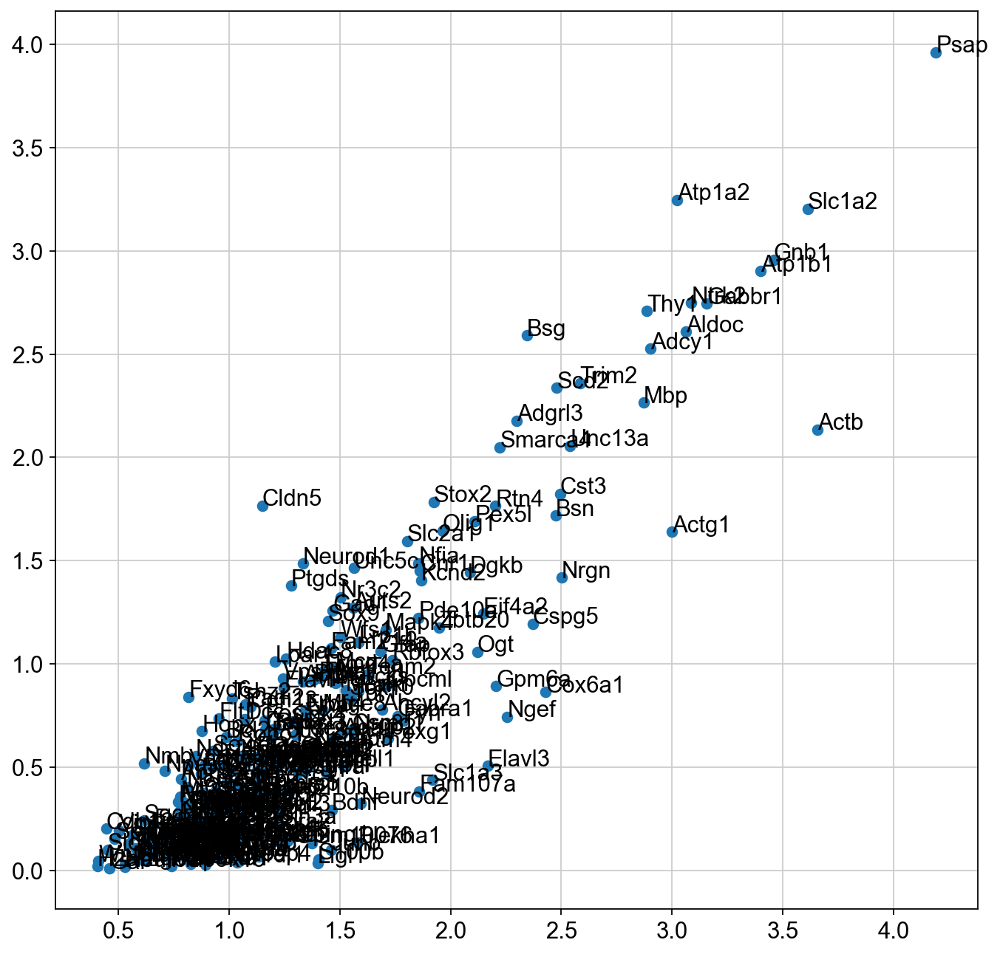

In [454]:
N1 = np.mean(scdata1[:,gns_][np.in1d(leid1,lu)].X,axis=0)
N2 = np.mean(scdata2[:,gns_][np.in1d(leid2,lu)].X,axis=0)
#N1 = np.mean(scdata1[:,gns_].X,axis=0)
#N2 = np.mean(scdata2[:,gns_].X,axis=0)
plt.plot(N1,N2,'o')
for x_,y_,gn in zip(N1,N2,gns_):
    plt.text(x_,y_,gn)
print(np.corrcoef(N1,N2)[0,1])

In [456]:
plot_gene_scdata(scdata2,gene='Actg1',nmax=20,sz_min=5,sz_max=30,transpose=1)

Viewer(axes=Axes(visible=False, labels=True, colored=True, dashed=False, arrows=True), camera=Camera(center=(0.0, -5325.135253906249, -1367.185546875), zoom=0.06641066665678576, angles=(0.0, 0.0, 90.0), perspective=0.0, interactive=True), cursor=Cursor(position=(1.0, 1.0), scaled=True, size=1, style=<CursorStyle.STANDARD: 'standard'>), dims=Dims(ndim=2, ndisplay=2, last_used=0, range=((-8365.40625, -2283.8642578125, 1.0), (-7025.35009765625, 4291.97900390625, 1.0)), current_step=(3041, 5659), order=(0, 1), axis_labels=('0', '1')), grid=GridCanvas(stride=1, shape=(-1, -1), enabled=False), layers=[<Points layer 'Actg1' at 0x25ad6b62130>], scale_bar=ScaleBar(visible=False, colored=False, color=array([1., 0., 1., 1.], dtype=float32), ticks=True, position=<Position.BOTTOM_RIGHT: 'bottom_right'>, font_size=10.0, box=False, box_color=array([0. , 0. , 0. , 0.6], dtype=float32), unit=None), text_overlay=TextOverlay(visible=False, color=array([0.5, 0.5, 0.5, 1. ], dtype=float32), font_size=10.0,

In [452]:
scdata3 = sc.read_h5ad(fls[0])
plot_gene_scdata(scdata3,gene='Sox9',nmax=20,sz_min=5,sz_max=30,transpose=1)

Viewer(axes=Axes(visible=False, labels=True, colored=True, dashed=False, arrows=True), camera=Camera(center=(0.0, 880.34912109375, -1729.578857421874), zoom=0.058862565510050556, angles=(0.0, 0.0, 90.0), perspective=0.0, interactive=True), cursor=Cursor(position=(1.0, 1.0), scaled=True, size=1, style=<CursorStyle.STANDARD: 'standard'>), dims=Dims(ndim=2, ndisplay=2, last_used=0, range=((-2503.9072265625, 4265.60546875, 1.0), (-8113.3046875, 4655.14697265625, 1.0)), current_step=(3384, 6384), order=(0, 1), axis_labels=('0', '1')), grid=GridCanvas(stride=1, shape=(-1, -1), enabled=False), layers=[<Points layer 'Sox9' at 0x25a85870430>], scale_bar=ScaleBar(visible=False, colored=False, color=array([1., 0., 1., 1.], dtype=float32), ticks=True, position=<Position.BOTTOM_RIGHT: 'bottom_right'>, font_size=10.0, box=False, box_color=array([0. , 0. , 0. , 0.6], dtype=float32), unit=None), text_overlay=TextOverlay(visible=False, color=array([0.5, 0.5, 0.5, 1. ], dtype=float32), font_size=10.0, p

In [486]:
def plot_gene_scdata(scdata2,gene='Sox10',nmax=20,sz_min=5,sz_max=30,transpose=1,flipx=1,flipy=1):
    Xcells = scdata2.obsm['X_spatial'][:,::transpose]*[flipx,flipy]
    ign = list(scdata2.var.index).index(gene)
    scdata2.obsm['X_spatial']
    if 'X_raw' not in scdata2.obsm:
        Xnorm = (np.exp(scdata2.X)-1)
        ncts = np.sum(Xnorm,axis=1)[0]
        scdata2.obsm['X_raw']=np.round(Xnorm/ncts*np.array(scdata2.obs['total_counts'])[:,np.newaxis])
    cts = scdata2.obsm['X_raw'][:,ign]

    cts[np.isnan(cts)]=0
    ncts = np.clip(cts/nmax,0,1)
    size = sz_min+ncts*(sz_max-sz_min)
    from matplotlib import cm as cmap
    cols = cmap.coolwarm(ncts)
    import napari
    good_cells = slice(None)


    #blanks = [gn for gn in df.columns if 'blank' in gn]
    #blanks_cts = np.nanmean(df[blanks],axis=-1)
    #good_cells = blanks_cts<th_blank

    XC = -Xcells[good_cells,::-1]
    viewer = napari.view_points(XC,size=size[good_cells],face_color=cols[good_cells],name=gene)
    if False:
        ifovs = np.array(list(df.index),dtype=int)//10**5
        ifov_unk = np.unique(ifovs)
        Xfov = np.array([np.mean(XC[ifovs==ifov],axis=0)for ifov in ifov_unk])
        features =  {'fov':ifov_unk}
        text = {
            'string': '{fov}',
            'size': 20,
            'color': 'gray',
            'translation': np.array([0, 0]),
        }
        viewer.add_points(Xfov,text=text,features=features,edge_width=0,edge_color=[0,0,0,0])
    return viewer

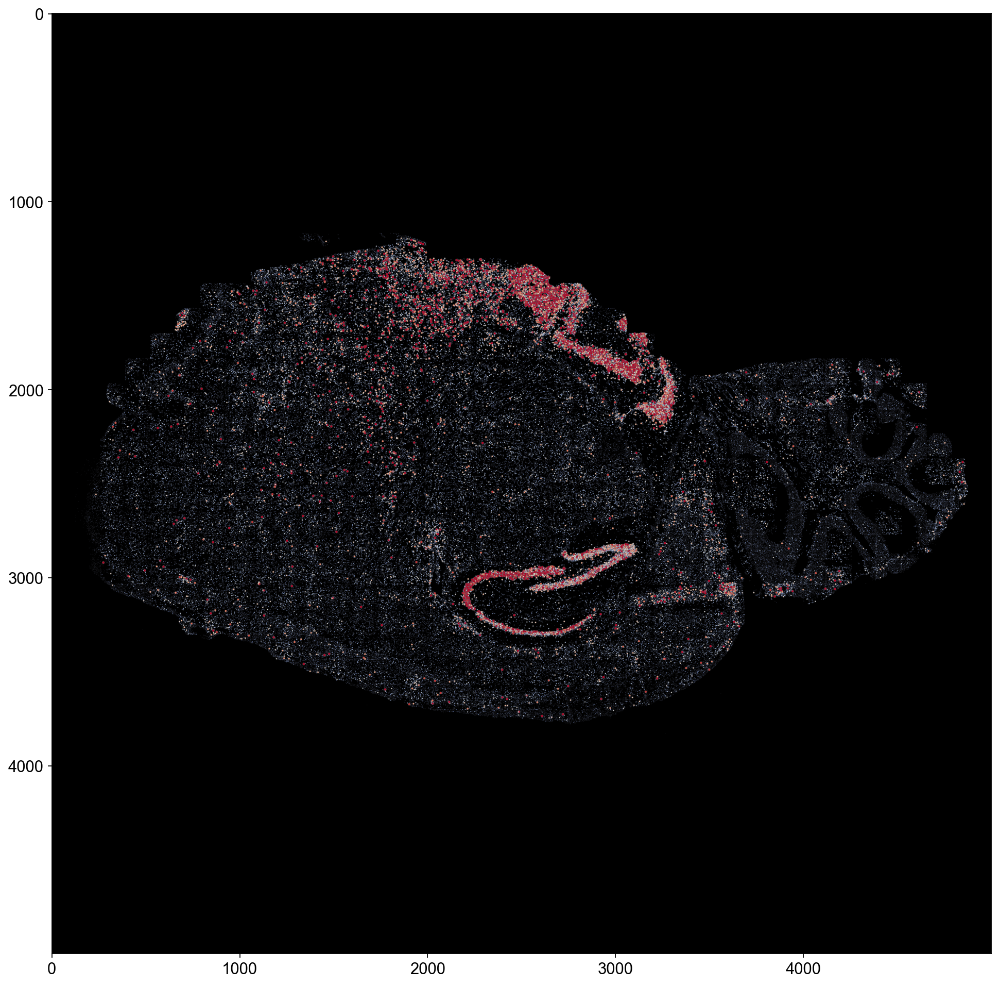

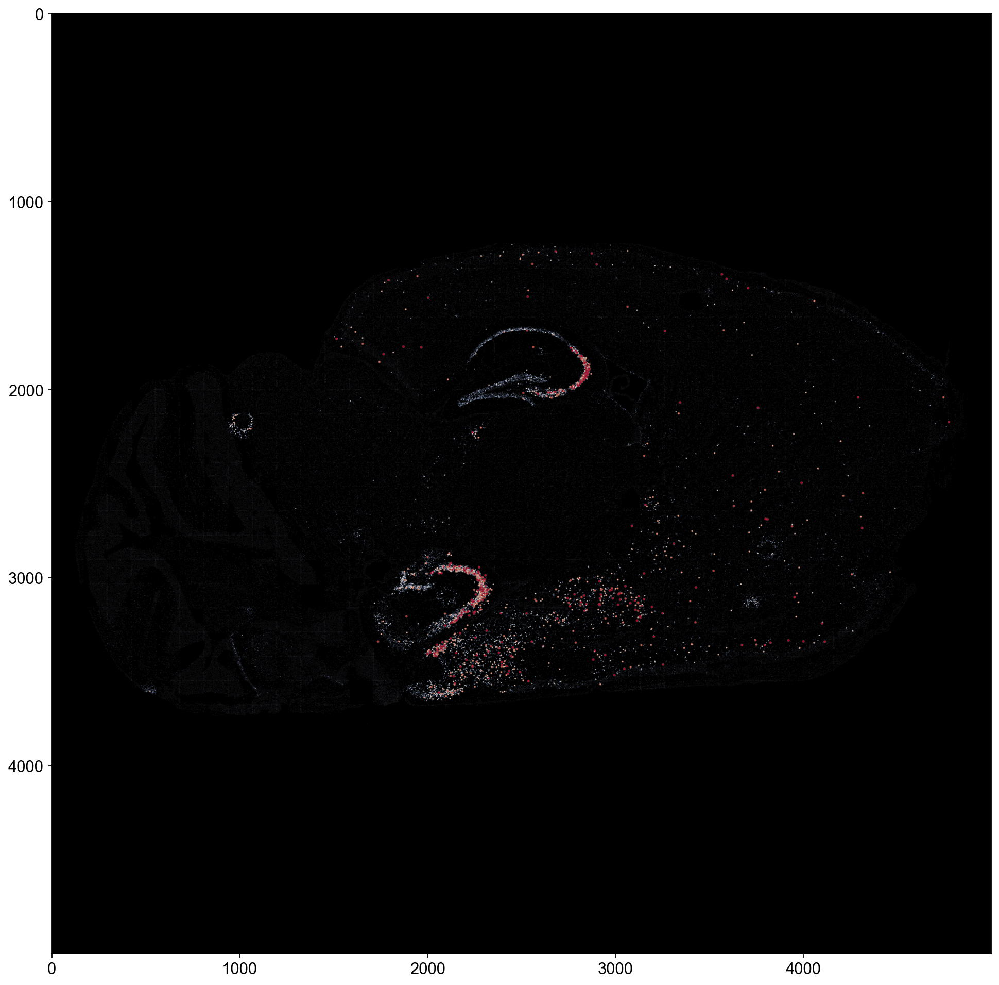

In [501]:
gene = 'Npy2r'
v = plot_gene_scdata(scdata1,gene)
im = v.screenshot(size=(5000,5000))
v.close()
plt.figure(figsize=(15,15))
plt.imshow(im)
plt.grid(None)
v = plot_gene_scdata(scdata2,gene)
im = v.screenshot(size=(5000,5000))
v.close()
plt.figure(figsize=(15,15))
plt.imshow(im)
plt.grid(None)

In [457]:
coefs = [np.corrcoef(M2[:,ign],M1[:,ign])[0,1] for ign,gn in enumerate(gns_)]
list(zip(np.array(gns_)[np.argsort(coefs)],np.sort(coefs)))

[('Vnn1', -0.3066285272413852),
 ('Neurog1', -0.11784140297836737),
 ('Nmb', -0.05133045728729702),
 ('Cdk1', -0.03925513940608735),
 ('Mxd3', -0.01388940673844439),
 ('Foxa1', 0.08522931722756887),
 ('Neurod4', 0.090311058971917),
 ('Map3k15', 0.0921445038144043),
 ('Rpl38', 0.12250898609666706),
 ('Tac2', 0.1331202021454879),
 ('Top2a', 0.1468759890285219),
 ('Rhcg', 0.176420554428635),
 ('Tfap2c', 0.17721869325858328),
 ('Sema3a', 0.18984088688678386),
 ('Myf5', 0.20960858030727603),
 ('Hes5', 0.2145080345205551),
 ('Gal', 0.2238750571242098),
 ('Myod1', 0.24119314024456348),
 ('Neurog2', 0.24148772699248072),
 ('H2afz', 0.24963014730562486),
 ('Etv4', 0.25819012169769956),
 ('Mgl2', 0.26865307196085875),
 ('Laptm5', 0.28787722882136974),
 ('Sox11', 0.2910286371598401),
 ('Ptbp2', 0.29548423778045374),
 ('Aldh1a1', 0.31530814138657454),
 ('Hmgn3', 0.315963151539612),
 ('Llgl1', 0.31725026445008714),
 ('Fxyd6', 0.3181306280769313),
 ('Kif4', 0.3224937195434611),
 ('Pnoc', 0.322926184

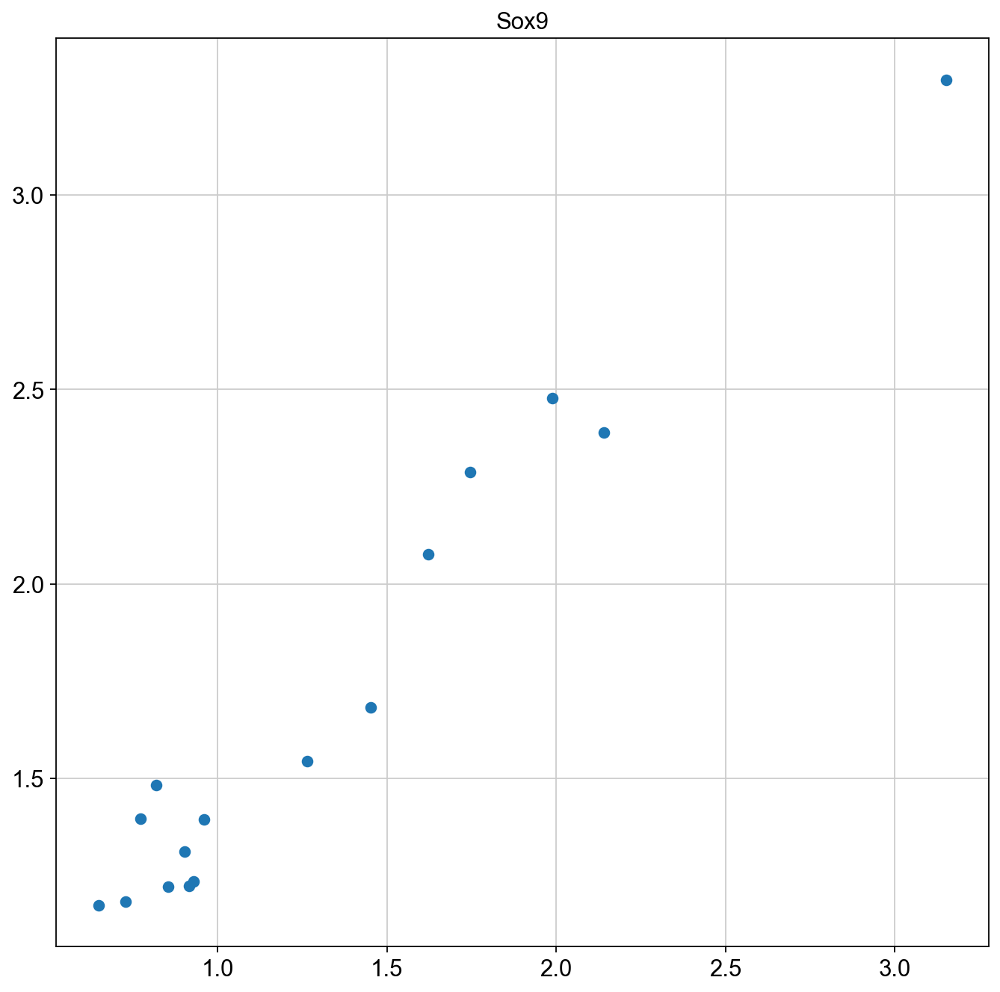

In [383]:
ign = list(gns_).index('Sox9')
plt.title(gns_[ign])
plt.plot(M2[:,ign],M1[:,ign],'o')

'DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023'

In [296]:
scdata2.write_h5ad(r'D:\scdatas'+os.sep+os.path.basename(os.path.dirname(save_folder))+'_iset'+str(iset)+'.h5ad')


View of AnnData object with n_obs × n_vars = 175262 × 275
    obs: 'n_genes', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'leiden'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'umap', 'pca'
    obsm: 'X_spatial', 'X_umap', 'X_pca'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [294]:
sc.tl.ingest(scdata1,scdata2,obs='leiden')

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=False)


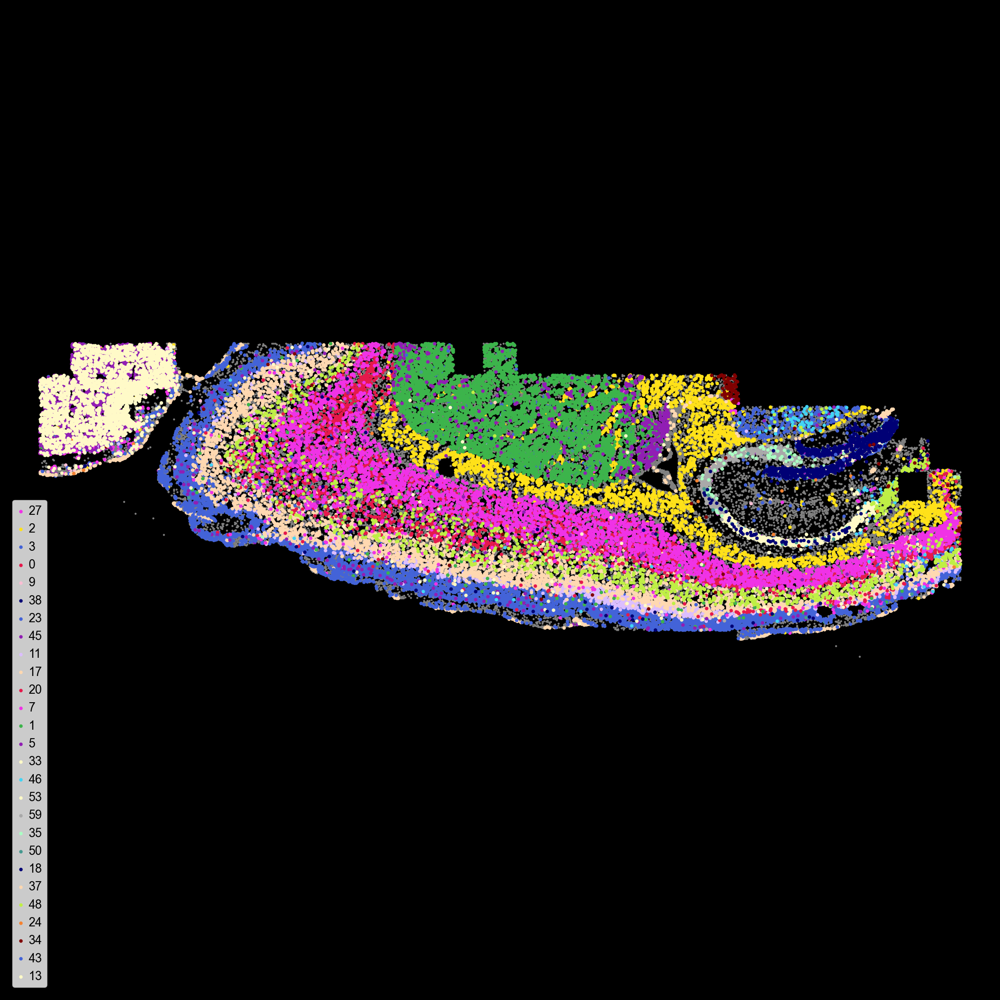

In [295]:
plot_cluster_scdata(scdata1,cmap,clusters=[27,2,3,0,9,38,23,45,11,17,20,7,1,5,33,46,53,59,35,50,18,37,48,24,34,43,13],transpose=1,flipx=1,flipy=-1)

In [272]:
#np.intersect1d(list(scdata2.var.index))

In [260]:
scdata1.obsm["X_raw"] = scdata1.X.copy()
sc.pp.calculate_qc_metrics(scdata1, percent_top=None, inplace=True)
sc.pp.normalize_total(scdata1, target_sum=np.median(scdata1.obs["total_counts"]))
sc.pp.log1p(scdata1)
sc.pp.neighbors(scdata1,use_rep = "X")  #metric='correlation', use_rep = "X"
#sc.tl.leiden(scdata1, resolution=2) 
#sc.tl.umap(scdata1,random_state=9)
sc.pp.pca(scdata1)

sc.tl.ingest(scdata1,scdata2,obs='leiden')

'\\\\192.168.0.100\\bbfish100\\DCBBL1_1year1wkNJ_ASO_SAL_4_18_2023\\MERFISH_Analysis'

In [ ]:
for i in range(60):
    pass
    #plot_cluster_scdata(scdata2,cmap,clusters=[i],transpose=1,flipx=1,flipy=-1)
    #plt.show()

C:\Users\BintuLabUser\AppData\Local\Temp\ipykernel_18636\2923372768.py:17: MatplotlibDeprecationWarning: The 'b' parameter of grid() has been renamed 'visible' since Matplotlib 3.5; support for the old name will be dropped two minor releases later.
  plt.grid(b=False)


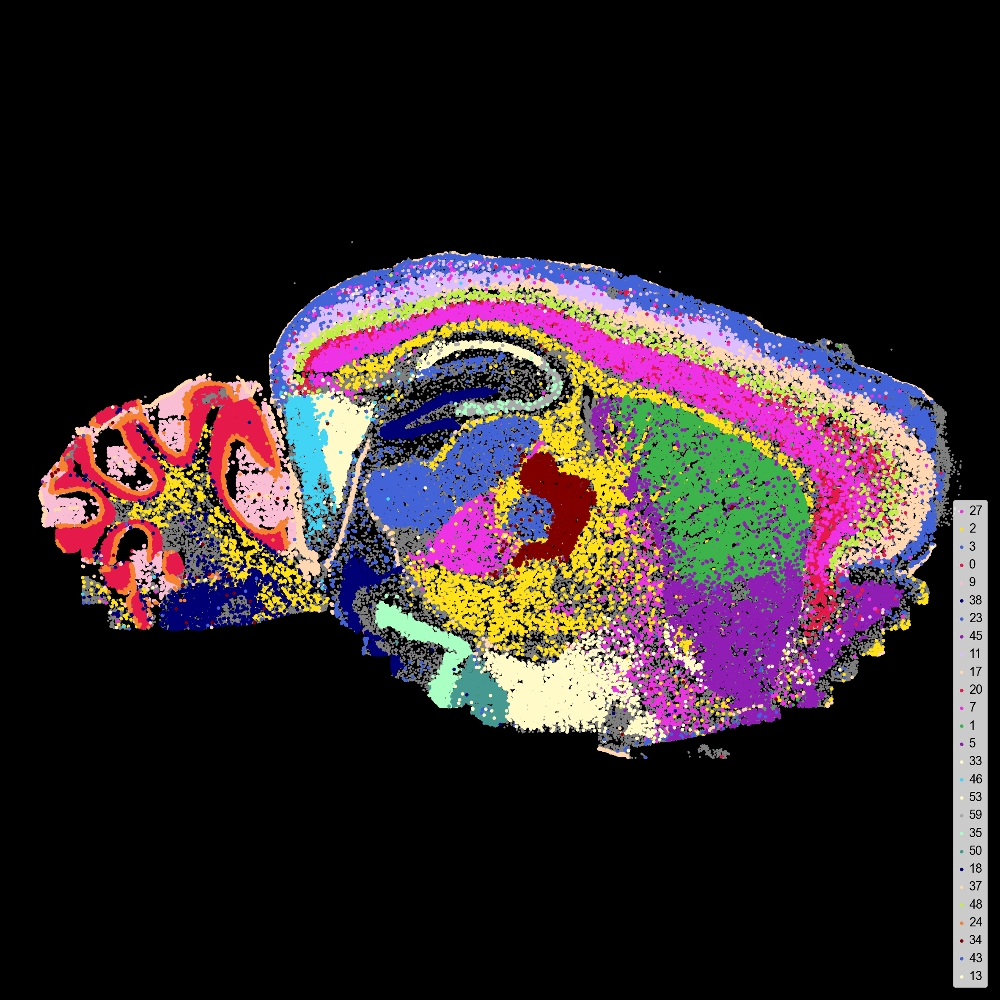

In [259]:
plot_cluster_scdata(scdata2,cmap,clusters=[27,2,3,0,9,38,23,45,11,17,20,7,1,5,33,46,53,59,35,50,18,37,48,24,34,43,13],transpose=1,flipx=1,flipy=-1)